In [1]:
import sys
print(sys.version)

import netCDF4 as nc
import numpy as np
#from mpl_toolkits.basemap import Basemap
from matplotlib import cm
import matplotlib.pyplot as plt
from pathlib import Path
%%time
import os
import warnings
import logging
from satpy import Scene
from glob import glob
from satpy import MultiScene
import satpy

from os import listdir
from os.path import isfile, join
import os
import xarray
from PIL import Image
#import satpy
import cv2
from tqdm.notebook import trange, tqdm
import time
from netCDF4 import Dataset
import matplotlib
import matplotlib.pyplot as plt
import numpy as np

import cv2
np.set_printoptions(threshold=sys.maxsize)

3.8.5 (default, Sep  3 2020, 21:29:08) [MSC v.1916 64 bit (AMD64)]
UsageError: Line magic function `%%time` not found.


In [10]:

def contrast_correction(color, contrast):
    """
    Modify the contrast of an R, G, or B color channel
    See: #www.dfstudios.co.uk/articles/programming/image-programming-algorithms/image-processing-algorithms-part-5-contrast-adjustment/
    Input:
        C - contrast level
    """
    F = (259*(contrast + 255))/(255.*259-contrast)
    COLOR = F*(color-.5)+.5
    COLOR = np.minimum(COLOR, 1)
    COLOR = np.maximum(COLOR, 0)
    return COLOR

def rebin(a, shape):
    sh = shape[0],a.shape[0]//shape[0],shape[1],a.shape[1]//shape[1]
    return a.reshape(sh).mean(-1).mean(1)


def is_convective(ds):
    ir = ds.variables['temp_11_0um_nom'][:]
    if np.percentile(ir, 25)>285:
        return True
    return False


def transform(file_channel1, file_channel2, file_channel3):
    # Reading in GOES-16 NetCDF
    g16nc = nc.Dataset(file_channel2, 'r')
    radiance = g16nc.variables['Rad'][:]
    g16nc.close()
    g16nc = None

    # Initial Radiance Plot
    fig = plt.figure(figsize=(6,6),dpi=200)
    im = plt.imshow(radiance, cmap='Greys_r')
    cb = fig.colorbar(im, orientation='horizontal')
    cb.set_ticks([1, 100, 200, 300, 400, 500, 600])
    cb.set_label('Radiance (W m-2 sr-1 um-1)')
    plt.show()

    # Radiance to Reflectance
    Esun_Ch_01 = 726.721072
    Esun_Ch_02 = 663.274497
    Esun_Ch_03 = 441.868715
    d2 = 0.3
    print("radiance : "+str(np.unique(radiance)))
    # Apply the formula to convert radiance to reflectance
    ref = (radiance * np.pi * d2) / Esun_Ch_02
    print("ref : "+str(np.unique(ref)))
    # Make sure all data is in the valid data range
    ref = np.maximum(ref, 0.0)
    ref = np.minimum(ref, 1.0)

    # Plot reflectance
    fig = plt.figure(figsize=(6,6),dpi=200)
    im = plt.imshow(ref, vmin=0.0, vmax=1.0, cmap='Greys_r')
    cb = fig.colorbar(im, orientation='horizontal')
    cb.set_ticks([0, 0.2, 0.4, 0.6, 0.8, 1.0])
    cb.set_label('Reflectance')
    plt.show()

    # Gamma correction
    # Apply the formula to adjust reflectance gamma
    ref_gamma = np.sqrt(ref)

    # Plot gamma adjusted reflectance
    fig = plt.figure(figsize=(6,6),dpi=200)
    im = plt.imshow(ref_gamma, vmin=0.0, vmax=1.0, cmap='Greys_r')
    cb = fig.colorbar(im, orientation='horizontal')
    cb.set_ticks([0, 0.2, 0.4, 0.6, 0.8, 1.0])
    cb.set_label('Reflectance')
    plt.show()

    # Psuedo-True Color Image
    # Load Channel 1 - Blue Visible
    g16nc = nc.Dataset(file_channel1, 'r')
    radiance_1 = g16nc.variables['Rad'][:]
    print("radiance_1 : "+str(np.unique(radiance_1)))
    g16nc.close()
    g16nc = None
    ref_1 = (radiance_1 * np.pi * d2) / Esun_Ch_01
    print("ref_1 : "+str(np.unique(ref_1)))
    # Make sure all data is in the valid data range
    ref_1 = np.maximum(ref_1, 0.0)
    ref_1 = np.minimum(ref_1, 1.0)
    ref_gamma_1 = np.sqrt(ref_1)

    # Plot gamma adjusted reflectance channel 1
    fig = plt.figure(figsize=(6,6),dpi=200)
    im = plt.imshow(ref_gamma_1, vmin=0.0, vmax=1.0, cmap='Greys_r')
    cb = fig.colorbar(im, orientation='horizontal')
    cb.set_ticks([0, 0.2, 0.4, 0.6, 0.8, 1.0])
    cb.set_label('Ch01 - Reflectance')
    plt.show()

    # Load Channel 3 - Veggie Near IR
    g16nc = nc.Dataset(file_channel3, 'r')
    radiance_3 = g16nc.variables['Rad'][:]
    print("radiance_3 : "+str(np.unique(radiance_3)))
    g16nc.close()
    g16nc = None
    ref_3 = (radiance_3 * np.pi * d2) / Esun_Ch_03
    print("ref_3 : "+str(np.unique(ref_3)))
    # Make sure all data is in the valid data range
    ref_3 = np.maximum(ref_3, 0.0)
    ref_3 = np.minimum(ref_3, 1.0)
    ref_gamma_3 = np.sqrt(ref_3)

    # Plot gamma adjusted reflectance channel 3
    fig = plt.figure(figsize=(6,6),dpi=200)
    im = plt.imshow(ref_gamma_3, vmin=0.0, vmax=1.0, cmap='Greys_r')
    cb = fig.colorbar(im, orientation='horizontal')
    cb.set_ticks([0, 0.2, 0.4, 0.6, 0.8, 1.0])
    cb.set_label('Ch03 - Reflectance')
    
    plt.show()

    ref_gamma_2 = rebin(ref_gamma, [10848, 10848])
    geocolor = np.stack([ref_gamma_2, ref_gamma_3, ref_gamma_1], axis=2)
    fig = plt.figure(figsize=(6,6),dpi=200)
    im = plt.imshow(geocolor)
    plt.title('GeoColor - Red - Veggie - Blue')
    plt.show()
    
    # Derived from Planet Labs data, CC > 0.9
    ref_gamma_true_green = 0.48358168 * ref_gamma_2 + 0.45706946 * ref_gamma_1 + 0.06038137 * ref_gamma_3

    truecolor = np.stack([ref_gamma_2, ref_gamma_true_green, ref_gamma_1], axis=2)
    fig = plt.figure(figsize=(6,6),dpi=200)
    im = plt.imshow(truecolor)
    plt.title('TrueColor - Red - Psuedo-Green - Blue')
    plt.show()

    return truecolor

def contrast_correction(color, contrast):
    """
    Modify the contrast of an R, G, or B color channel
    See: #www.dfstudios.co.uk/articles/programming/image-programming-algorithms/image-processing-algorithms-part-5-contrast-adjustment/
    Input:
        C - contrast level
    """
    F = (259*(contrast + 255))/(255.*259-contrast)
    COLOR = F*(color-.5)+.5
    COLOR = np.minimum(COLOR, 1)
    COLOR = np.maximum(COLOR, 0)
    return COLOR

def is_convective(ds):
    ir = ds.variables['temp_11_0um_nom'][:]
    if np.percentile(ir, 25)>285:
        return True
    return False

def NormalizeData(arr):
    return ((arr - arr.min()) * (1/(arr.max() - arr.min()) * 255)).astype('uint8')

def norm(x):
    return (x-x.max())/(x.max()-x.min())

def protocol2(file, plot=False):
    ds = nc.Dataset(file)
    c1 = ds.variables['refl_0_65um_nom'][:].filled(0).astype(np.uint8)
    c2 = ds.variables['refl_0_86um_nom'][:].filled(0).astype(np.uint8)
    c3 = ds.variables['refl_0_47um_nom'][:].filled(0).astype(np.uint8)
    
    print("C3 Unique : "+str(np.unique(c3)))

    R = c3
    G = c2
    B = c1
    """
    R = norm(R)
    G = norm(G)
    B = norm(B)
    
    # Apply the gamma correction
    """
    gamma = 0.4
    R = np.power(R, gamma).astype(np.uint8)
    G = np.power(G, gamma).astype(np.uint8)
    B = np.power(B, gamma).astype(np.uint8)
    """
    
    # Calculate the "True" Green
    G_true = 0.48358168 * R + 0.45706946 * B + 0.06038137 * G
    G_true = np.maximum(G_true, 0).astype(np.uint8)
    G_true = np.minimum(G_true, 1).astype(np.uint8)

    # Modify the RGB color contrast:
    
    R = NormalizeData(R)
    G = NormalizeData(G)
    B = NormalizeData(B)    
    """
    contrast = 125
    print("Unique : "+str(np.unique(R)))
    RGB_contrast = np.dstack([R, G, B])
    #RGB_contrast = RGB_contrast*(255/RGB_contrast.max())
    #RGB_contrast = contrast_correction(RGB_contrast, contrast)
    #RGB_contrast *= 255
    dx = np.dstack([c3, c2, c1])
    #cv2.imwrite('Test_gray.jpg',RGB_contrast)
    #cv2.imwrite('Test_gray2.jpg',dx)
    
    print("RGB_contrast : "+str(np.unique(RGB_contrast)))

    
    fig, axs = plt.subplots(1,8, figsize=(25,7))
    fig.suptitle('Different stages')
    
    axs[0].imshow(R)
    axs[0].title.set_text('R')
    axs[1].imshow(G)
    axs[1].title.set_text('G')
    axs[2].imshow(B)
    axs[2].title.set_text('B')

    axs[3].imshow(RGB_contrast)
    axs[3].title.set_text('RGB_contrast')
    
    axs[4].imshow(c1)
    axs[4].title.set_text('Channel 1')
    axs[5].imshow(c2)
    axs[5].title.set_text('Channel 2')
    axs[6].imshow(c3)
    axs[6].title.set_text('Channel 3')
    
    
    #print("DX UNIQUES : "+str(np.unique(dx)))
    axs[7].imshow(dx)
    axs[7].title.set_text('DX')
    
    print("RGB_contrast : \n"+str(np.unique(RGB_contrast)))    
    plt.figure()
    print(RGB_contrast.shape)
    plt.imshow(RGB_contrast)
    plt.show()


def transform_nc(file, plot=False):
    # Reading in GOES-16 NetCDF
    g16nc = nc.Dataset(file, 'r')
    
    radiance = g16nc.variables['refl_0_65um_nom'][:]
    print("radiance : "+str(np.unique(radiance)))
    g16nc.close()
    g16nc = None

    if plot:
        # Initial Radiance Plot
        fig = plt.figure(figsize=(6,6),dpi=200)
        im = plt.imshow(radiance, cmap='Greys_r')
        cb = fig.colorbar(im, orientation='horizontal')
        cb.set_ticks([1, 100, 200, 300, 400, 500, 600])
        cb.set_label('Radiance (W m-2 sr-1 um-1)')
        plt.show()

    # Radiance to Reflectance
    Esun_Ch_01 = 726.721072
    Esun_Ch_02 = 663.274497
    Esun_Ch_03 = 441.868715
    d2 = 0.3

    # Apply the formula to convert radiance to reflectance
    ref = (radiance * np.pi * d2) / Esun_Ch_02
    print("ref : "+str(np.unique(ref)))
    # Make sure all data is in the valid data range
    ref = np.maximum(ref, 0.0)
    ref = np.minimum(ref, 1.0)

    if plot:
        # Plot reflectance
        fig = plt.figure(figsize=(6,6),dpi=200)
        im = plt.imshow(ref, vmin=0.0, vmax=1.0, cmap='Greys_r')
        cb = fig.colorbar(im, orientation='horizontal')
        cb.set_ticks([0, 0.2, 0.4, 0.6, 0.8, 1.0])
        cb.set_label('Reflectance')
        plt.show()

    # Gamma correction
    # Apply the formula to adjust reflectance gamma
    ref_gamma = np.sqrt(ref)

    if plot:
        # Plot gamma adjusted reflectance
        fig = plt.figure(figsize=(6,6),dpi=200)
        im = plt.imshow(ref_gamma, vmin=0.0, vmax=1.0, cmap='Greys_r')
        cb = fig.colorbar(im, orientation='horizontal')
        cb.set_ticks([0, 0.2, 0.4, 0.6, 0.8, 1.0])
        cb.set_label('Reflectance')
        plt.show()

    # Psuedo-True Color Image
    # Load Channel 1 - Blue Visible
    g16nc = nc.Dataset(file, 'r')
    radiance_1 = g16nc.variables['refl_0_47um_nom'][:]
    print("radiance_1 : "+str(np.unique(radiance_1)))
    g16nc.close()
    g16nc = None
    ref_1 = (radiance_1 * np.pi * d2) / Esun_Ch_01
    print("ref_1 : "+str(np.unique(ref_1)))
    # Make sure all data is in the valid data range
    ref_1 = np.maximum(ref_1, 0.0)
    ref_1 = np.minimum(ref_1, 1.0)
    ref_gamma_1 = np.sqrt(ref_1)

    if plot:
        # Plot gamma adjusted reflectance channel 1
        fig = plt.figure(figsize=(6,6),dpi=200)
        im = plt.imshow(ref_gamma_1, vmin=0.0, vmax=1.0, cmap='Greys_r')
        cb = fig.colorbar(im, orientation='horizontal')
        cb.set_ticks([0, 0.2, 0.4, 0.6, 0.8, 1.0])
        cb.set_label('Ch01 - Reflectance')
        plt.show()

    # Load Channel 3 - Veggie Near IR
    g16nc = nc.Dataset(file, 'r')
    radiance_3 = g16nc.variables['refl_0_86um_nom'][:]
    print("radiance_3 : "+str(np.unique(radiance_3)))
    g16nc.close()
    g16nc = None
    ref_3 = (radiance_3 * np.pi * d2) / Esun_Ch_03
    print("ref_3 : "+str(np.unique(ref_3)))
    # Make sure all data is in the valid data range
    ref_3 = np.maximum(ref_3, 0.0)
    ref_3 = np.minimum(ref_3, 1.0)
    ref_gamma_3 = np.sqrt(ref_3)

    if plot:
        # Plot gamma adjusted reflectance channel 3
        fig = plt.figure(figsize=(6,6),dpi=200)
        im = plt.imshow(ref_gamma_3, vmin=0.0, vmax=1.0, cmap='Greys_r')
        cb = fig.colorbar(im, orientation='horizontal')
        cb.set_ticks([0, 0.2, 0.4, 0.6, 0.8, 1.0])
        cb.set_label('Ch03 - Reflectance')
        plt.show()

    ref_gamma_2 = rebin(ref_gamma, list(ref_gamma_3.shape))
    geocolor = np.stack([ref_gamma_2, ref_gamma_3, ref_gamma_1], axis=2)

    if plot:
        fig = plt.figure(figsize=(6,6),dpi=200)
        im = plt.imshow(geocolor)
        plt.title('GeoColor - Red - Veggie - Blue')
        plt.show()
    
    # Derived from Planet Labs data, CC > 0.9
    ref_gamma_true_green = 0.48358168 * ref_gamma_2 + 0.45706946 * ref_gamma_1 + 0.06038137 * ref_gamma_3
    if plot:
        truecolor = np.stack([ref_gamma_2, ref_gamma_true_green, ref_gamma_1], axis=2)
        fig = plt.figure(figsize=(6,6),dpi=200)
        im = plt.imshow(truecolor)
        plt.title('TrueColor - Red - Psuedo-Green - Blue')
        plt.show()
        # We'll use the `CMI_C02` variable as a 'hook' to get the CF metadata.
    
    gamma = 0.25
    B, R, G = ref_1, ref, ref_3
    R = np.power(R, gamma)
    G = np.power(G, gamma)
    B = np.power(B, gamma)
    # print '\n   Gamma correction: %s' % gamma

    # Calculate the "True" Green
    G_true = 0.48358168 * R + 0.45706946 * B + 0.06038137 * G
    G_true = np.maximum(G_true, 0)
    G_true = np.minimum(G_true, 1)

    # Modify the RGB color contrast:
    contrast = 250
    arr_img = np.dstack([R, G_true, B])
    arr_img = contrast_correction(arr_img, contrast)
    if plot:
        fig = plt.figure(figsize=(6,6),dpi=200)
        im = plt.imshow(arr_img)
        plt.show()
    return arr_img
    
def plot_nc(file, title):
    # Reading in GOES-16 NetCDF
    g16nc = nc.Dataset(file, 'r')
    
    radiance = g16nc.variables['refl_0_65um_nom'][:]
    print("radiance : "+str(np.unique(radiance)))


    Esun_Ch_01 = 726.721072
    Esun_Ch_02 = 663.274497
    Esun_Ch_03 = 441.868715
    d2 = 0.3

    ref = (radiance * np.pi * d2) / Esun_Ch_02
    ref = np.maximum(ref, 0.0)
    ref = np.minimum(ref, 1.0)

    ref_gamma = np.sqrt(ref)

    radiance_1 = g16nc.variables['refl_0_47um_nom'][:]
    ref_1 = (radiance_1 * np.pi * d2) / Esun_Ch_01
    ref_1 = np.maximum(ref_1, 0.0)
    ref_1 = np.minimum(ref_1, 1.0)
    ref_gamma_1 = np.sqrt(ref_1)
    radiance_3 = g16nc.variables['refl_0_86um_nom'][:]
    g16nc.close()
    g16nc = None
    ref_3 = (radiance_3 * np.pi * d2) / Esun_Ch_03
    ref_3 = np.maximum(ref_3, 0.0)
    ref_3 = np.minimum(ref_3, 1.0)
    ref_gamma_3 = np.sqrt(ref_3)

    ref_gamma_2 = rebin(ref_gamma, list(ref_gamma_3.shape))
    geocolor = np.stack([ref_gamma_2, ref_gamma_3, ref_gamma_1], axis=2)

    ref_gamma_true_green = 0.48358168 * ref_gamma_2 + 0.45706946 * ref_gamma_1 + 0.06038137 * ref_gamma_3    
    gamma = 0.25
    B, R, G = ref_1, ref, ref_3
    R = np.power(R, gamma)
    G = np.power(G, gamma)
    B = np.power(B, gamma)

    G_true = 0.48358168 * R + 0.45706946 * B + 0.06038137 * G
    G_true = np.maximum(G_true, 0)
    G_true = np.minimum(G_true, 1)

    contrast = 250
    arr_img = np.dstack([R, G_true, B])
    arr_img = contrast_correction(arr_img, contrast)
    plt.rcParams["figure.figsize"] = (20,20)
    plt.imshow(arr_img)
    plt.title(title)
    plt.show()    

def NormalizeData(arr):
    return ((arr - arr.min()) * (1/(arr.max() - arr.min()) * 255)).astype('uint8')

def norm(x):
    return (x-x.max())/(x.max()-x.min())




to open : ..\NC\2km_10min\2020\2020_01_22\clavrx_OR_ABI-L1b-RadF-M6C01_G16_s20200221740165_BARBADOS-2KM-FD.level2.nc
<ipython-input-26-5e2e44cc6fae>:245: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  radiance = g16nc.variables['refl_0_65um_nom'][:]
radiance : [2.5591278076171875 2.7024765014648438 2.7155075073242188 ...
 100.17922973632812 100.45848083496094 --]


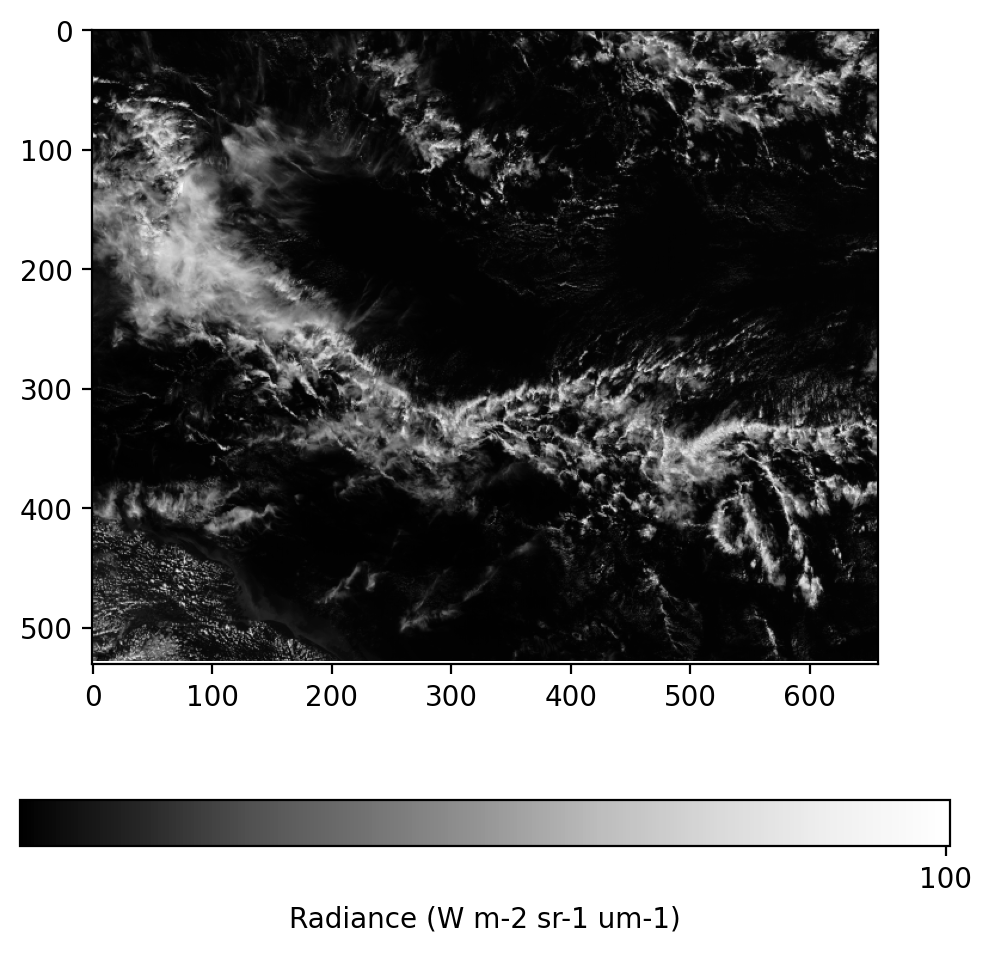

ref : [0.003636385314166546 0.003840075805783272 0.003858592128381133 ...
 0.14234937727451324 0.1427461802959442 --]


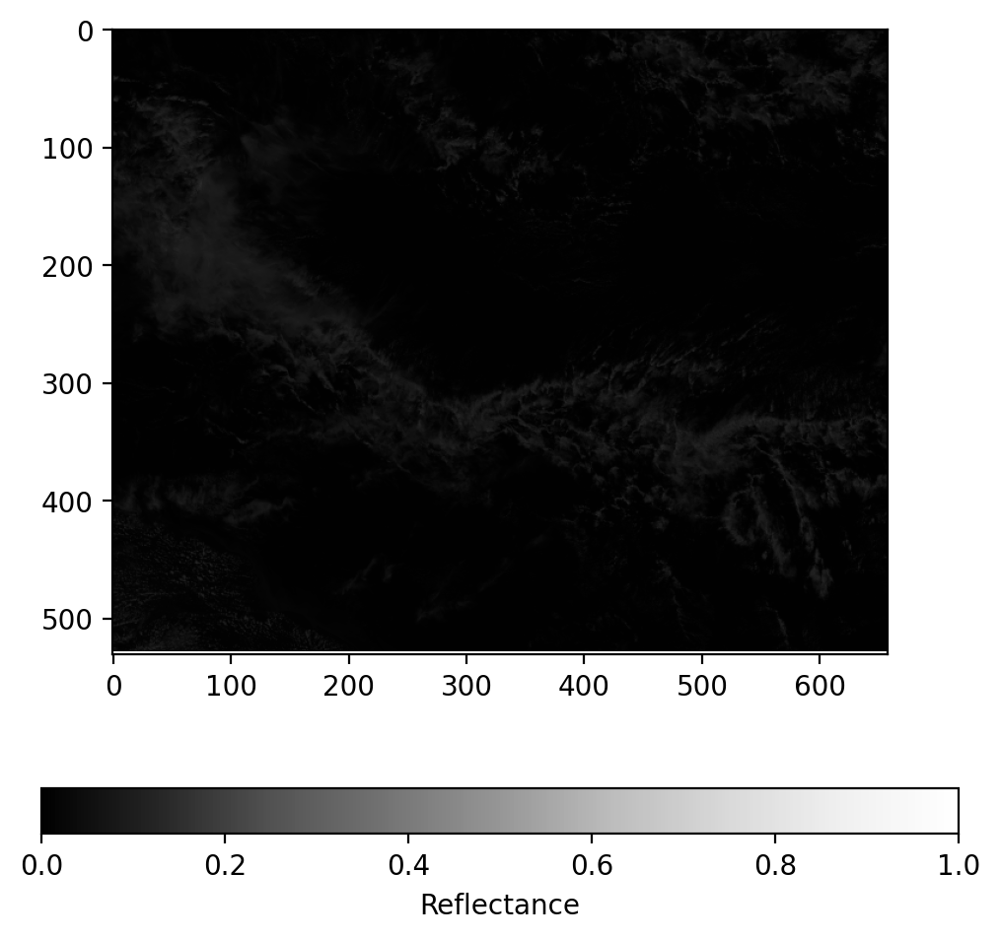

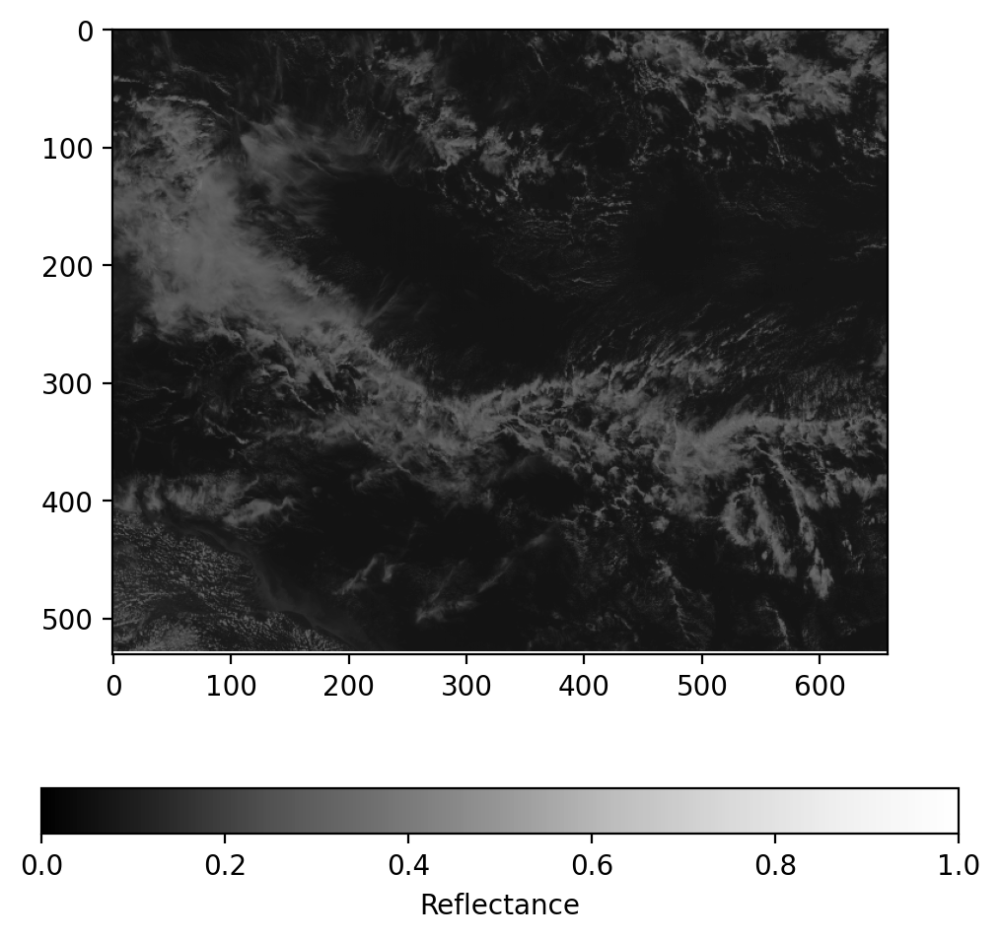

<ipython-input-26-5e2e44cc6fae>:297: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  radiance_1 = g16nc.variables['refl_0_47um_nom'][:]
radiance_1 : [8.832820892333984 8.83468246459961 9.672412872314453 ...
 106.21649932861328 106.76009368896484 --]
ref_1 : [0.011455204337835312 0.011457618325948715 0.012544062919914722 ...
 0.13775120675563812 0.13845618069171906 --]


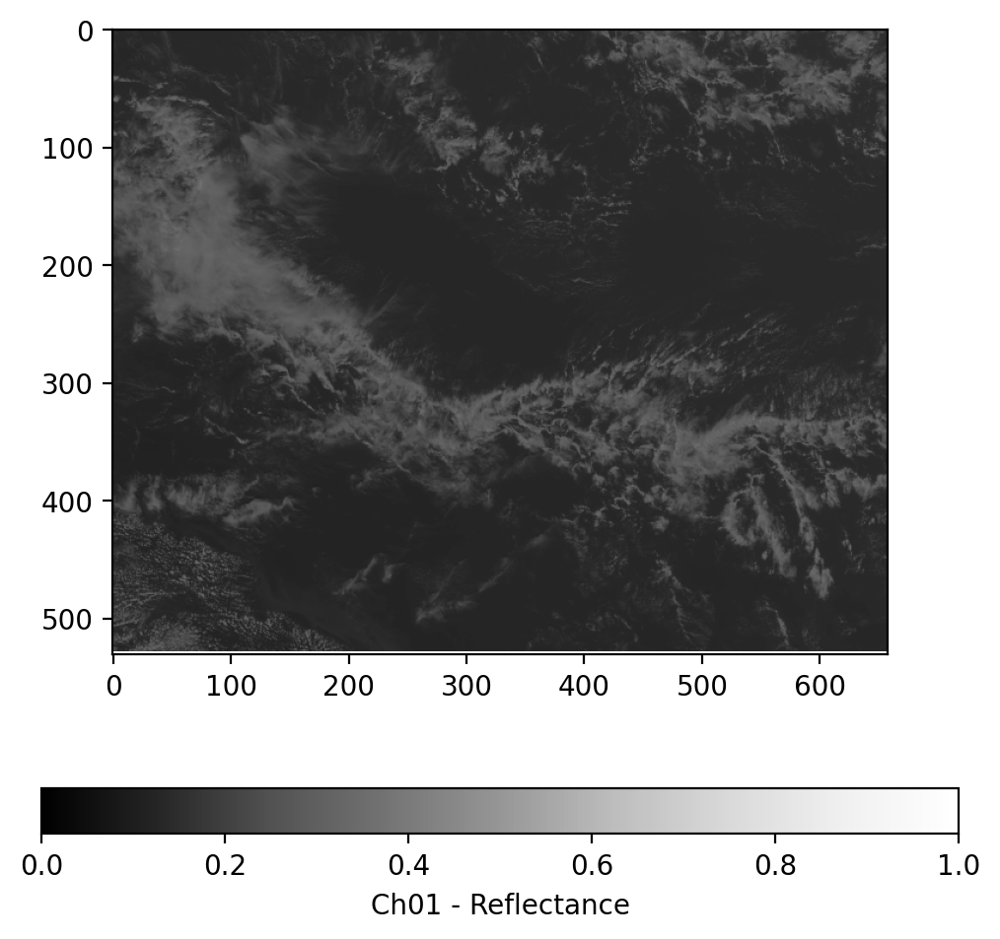

<ipython-input-26-5e2e44cc6fae>:319: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  radiance_3 = g16nc.variables['refl_0_86um_nom'][:]
radiance_3 : [1.1554603576660156 1.1684913635253906 1.1926956176757812 ...
 114.18985748291016 114.55287170410156 --]
ref_3 : [0.0024645235389471054 0.002492317697033286 0.0025439439341425896 ...
 0.24355970323085785 0.24433399736881256 --]


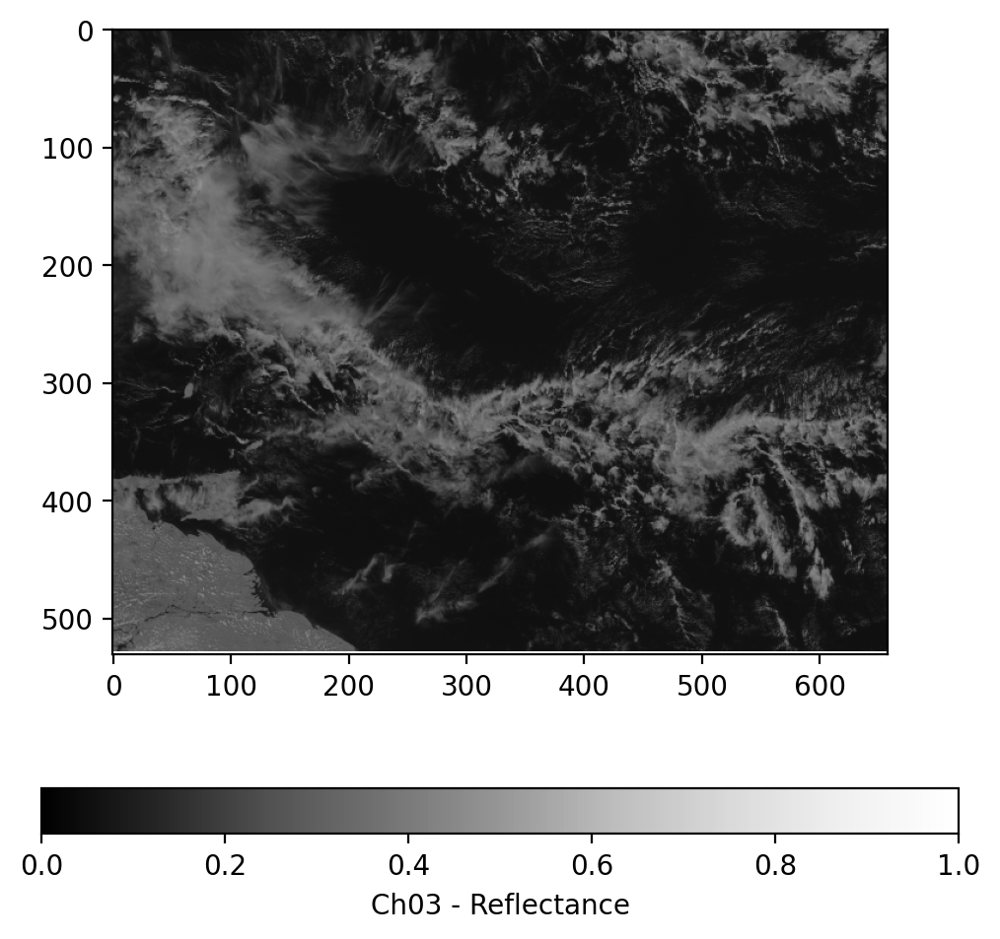

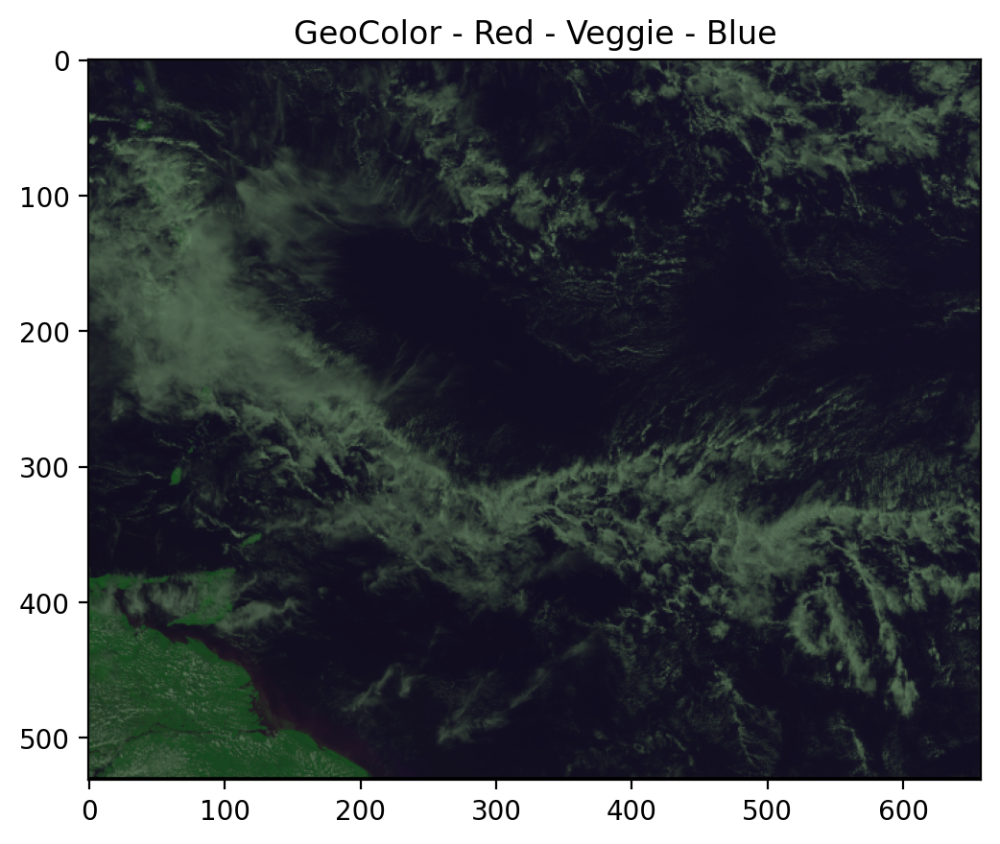

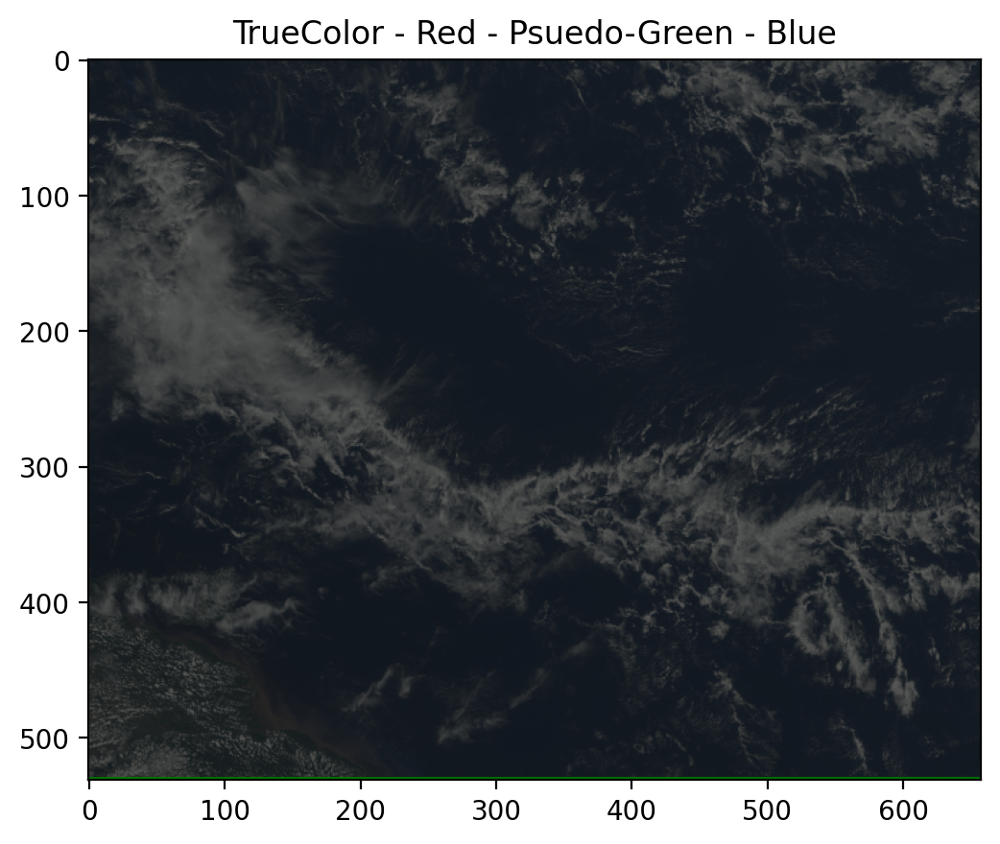

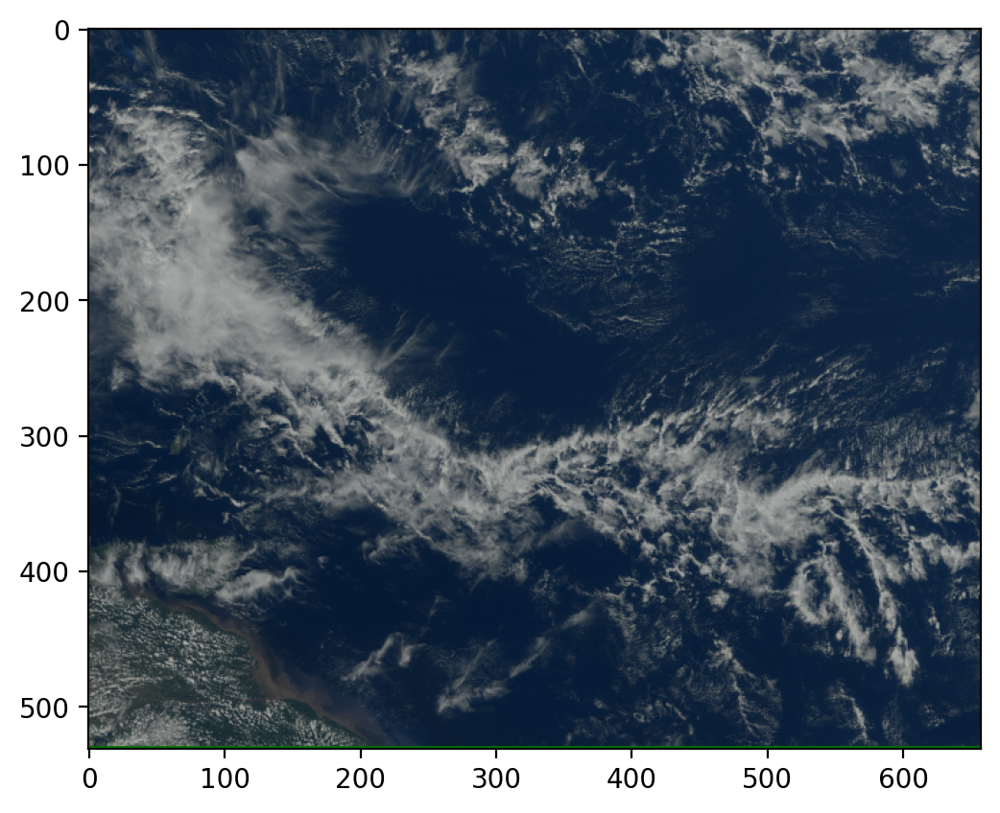


Not read : 0
Number images : 0


In [27]:
path = "..\\NC\\2km_10min\\2020\\2020_01_22\\" #  /C:\Users\Ray\Documents\NC\2km_10min\2020\2020_01_22
from tqdm.notebook import tqdm

files_paths = list()
for (dirpath, dirnames, filenames) in os.walk(path):
    files_paths += [os.path.join(dirpath, file) for file in filenames]
files_paths = [files_paths[106]]
shown = 0
lower_val = np.array([75,0,0]) 
upper_val = np.array([105,255,255]) 
not_red = 0
num_images = 0
count = 0
for to_open in tqdm(files_paths):
    print("to open : "+str(to_open))
    ds = nc.Dataset(to_open)
    #print(ds)
    barbados = transform_nc(to_open, plot=True)
    
print("Not read : "+str(not_red))
print("Number images : "+str(num_images))
plt.show()

to open : ..\NC\2km_10min\2020\2020_01_22\clavrx_OR_ABI-L1b-RadF-M6C01_G16_s20200220000166_BARBADOS-2KM-FD.level2.nc
radiance : [--]
<ipython-input-12-2434c0dcc864>:17: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  title = str(ds.__dict__["date_created"]) + " | " +str(ds.__dict__["START_TIME"])+ " | " +str(ds.__dict__["END_TIME"])
<ipython-input-10-fc0f686231b4>:384: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  radiance = g16nc.variables['refl_0_65um_nom'][:]
<ipython-input-10-fc0f686231b4>:399: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modif

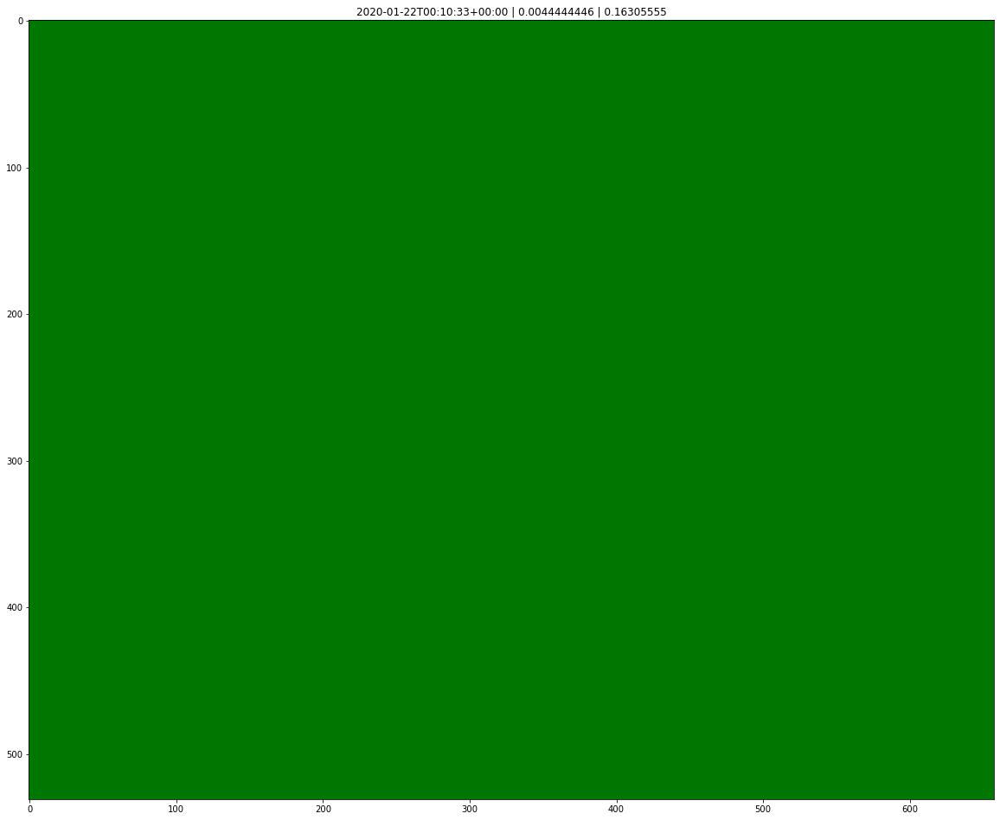


Not read : 0
Number images : 0


In [12]:
path = "..\\NC\\2km_10min\\2020\\2020_01_22\\" #  /C:\Users\Ray\Documents\NC\2km_10min\2020\2020_01_22
from tqdm.notebook import tqdm

files_paths = list()
for (dirpath, dirnames, filenames) in os.walk(path):
    files_paths += [os.path.join(dirpath, file) for file in filenames]
#files_paths = [files_paths[106]]
shown = 0
lower_val = np.array([75,0,0]) 
upper_val = np.array([105,255,255]) 
not_red = 0
num_images = 0
count = 0
for to_open in tqdm(files_paths):
    print("to open : "+str(to_open))
    ds = nc.Dataset(to_open)
    title = str(ds.__dict__["date_created"]) + " | " +str(ds.__dict__["START_TIME"])+ " | " +str(ds.__dict__["END_TIME"])
    plot_nc(to_open, title)
    break
print("Not read : "+str(not_red))
print("Number images : "+str(num_images))
plt.show()

to open : ..\NC\2km_10min\2020\2020_01_22\clavrx_OR_ABI-L1b-RadF-M6C01_G16_s20200221740165_BARBADOS-2KM-FD.level2.nc
C3 Unique : [  0   8   9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24
  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42
  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  99 100 102 103 105 106]
Unique : [0 2 3 4 5 6]
RGB_contrast : [0 1 2 3 4 5 6]
<ipython-input-24-5e2e44cc6fae>:163: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  c1 = ds.variab

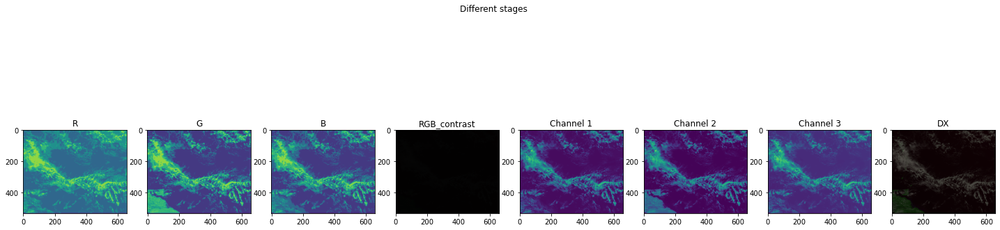

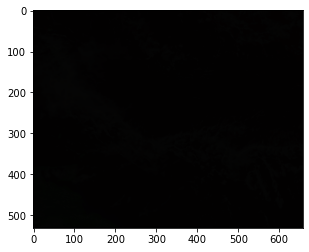

In [25]:
import cv2

print("to open : "+str(to_open))
protocol2(to_open)

In [25]:
file_channel2 = "..\\NC\\aws\\OR_ABI-L1b-RadF-M6C02_G16_s20200221740165_e20200221749473_c20200221749525.nc"
file_channel1 = "..\\NC\\aws\\OR_ABI-L1b-RadF-M6C01_G16_s20200221740165_e20200221749473_c20200221749532.nc"
file_channel3 = "..\\NC\\aws\\OR_ABI-L1b-RadF-M6C03_G16_s20200221740165_e20200221749473_c20200221749541.nc"

<ipython-input-23-a5aabae5e356>:29: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  radiance = g16nc.variables['Rad'][:]
<ipython-input-23-a5aabae5e356>:29: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  radiance = g16nc.variables['Rad'][:]


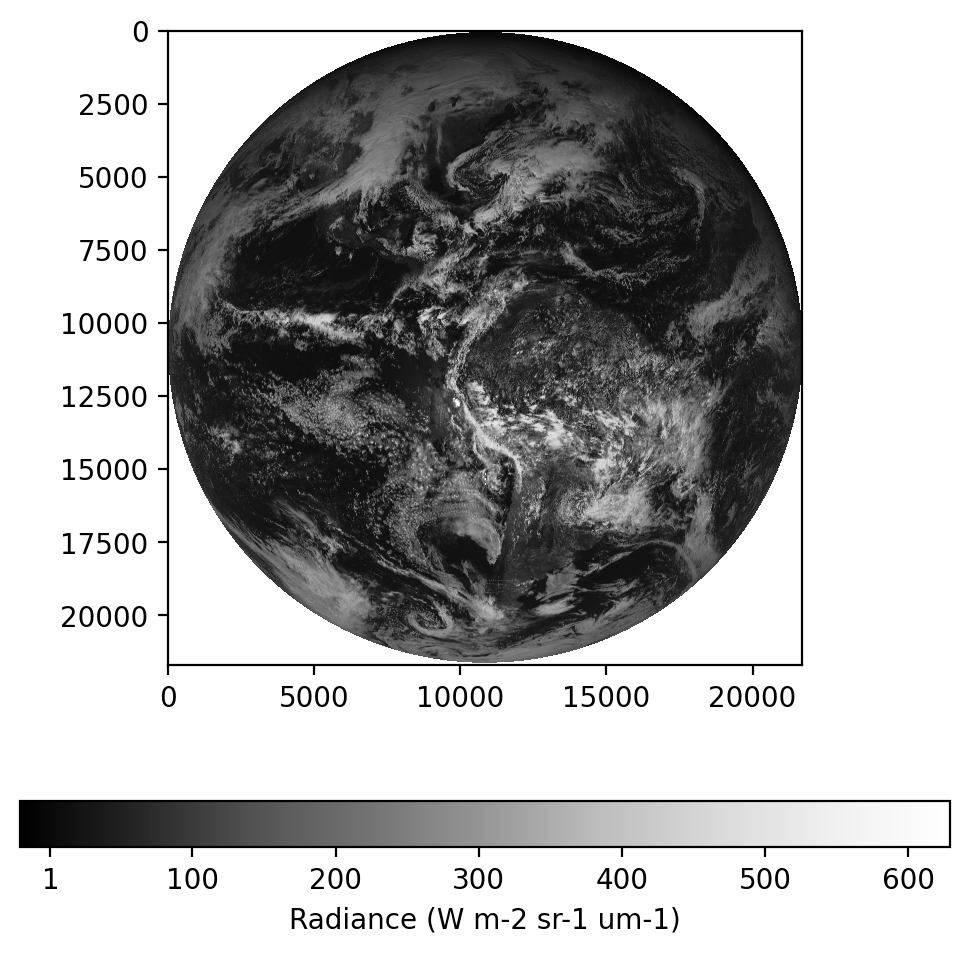

radiance : [-20.2899112701416 -1.5760116577148438 -1.41741943359375 ...
 628.8286743164062 628.9872436523438 --]
ref : [-0.028830885887145996 -0.0022394289262592793 -0.00201407796703279 ...
 0.8935322165489197 0.8937574625015259 --]


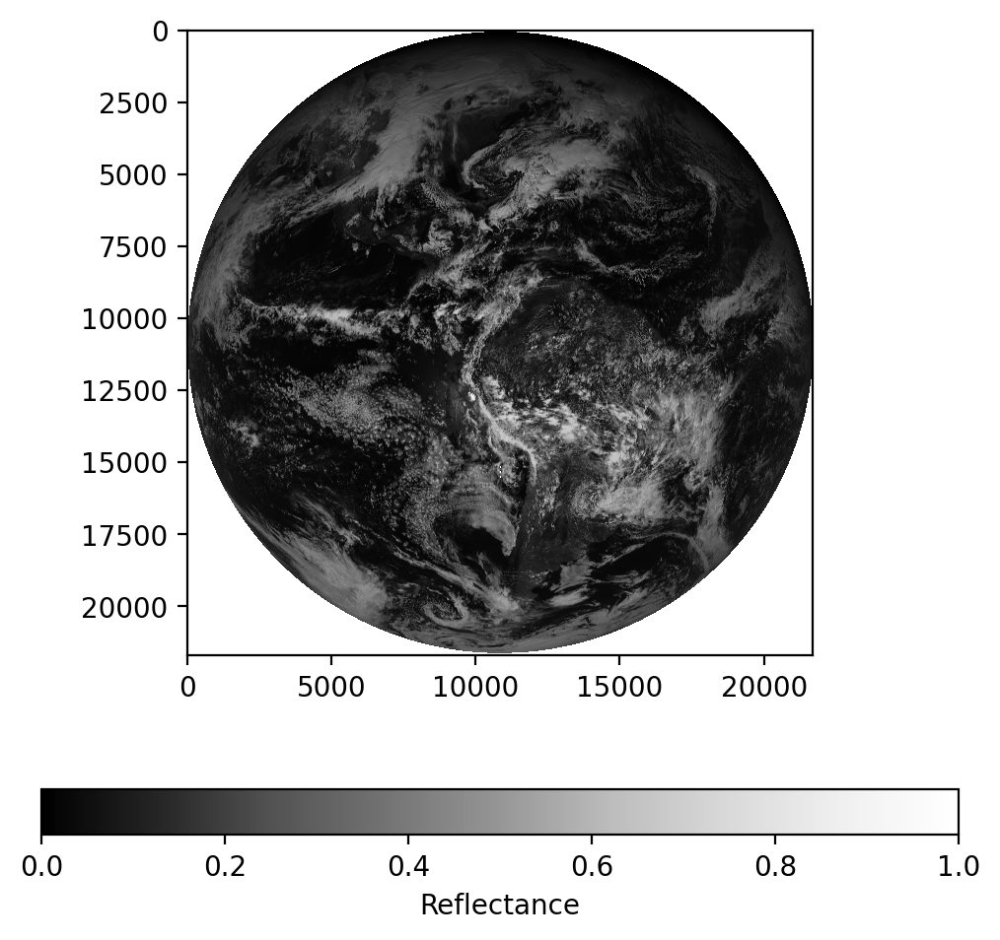

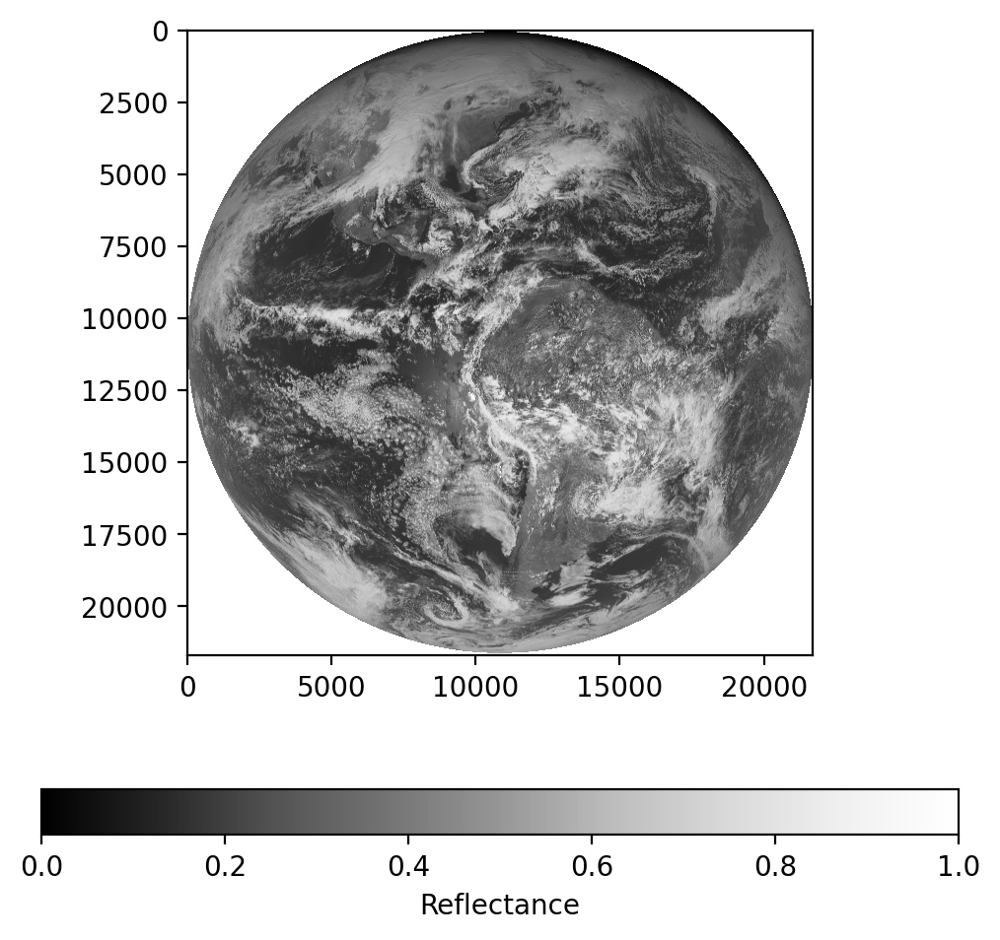

<ipython-input-23-a5aabae5e356>:77: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  radiance_1 = g16nc.variables['Rad'][:]
<ipython-input-23-a5aabae5e356>:77: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  radiance_1 = g16nc.variables['Rad'][:]
radiance_1 : [0.05075645446777344 0.8628635406494141 1.6749687194824219
 2.4870758056640625 3.2991809844970703 4.111288070678711 4.923395156860352
 5.735500335693359 6.547605514526367 7.359712600708008 8.171819686889648
 8.983926773071289 9.79603385925293 10.60814094543457 11.420244216918945
 12.232351303100586 13.044458389282227 13.856565475463867
 14.668672561645508 15.480775833129883 16.292882919311523

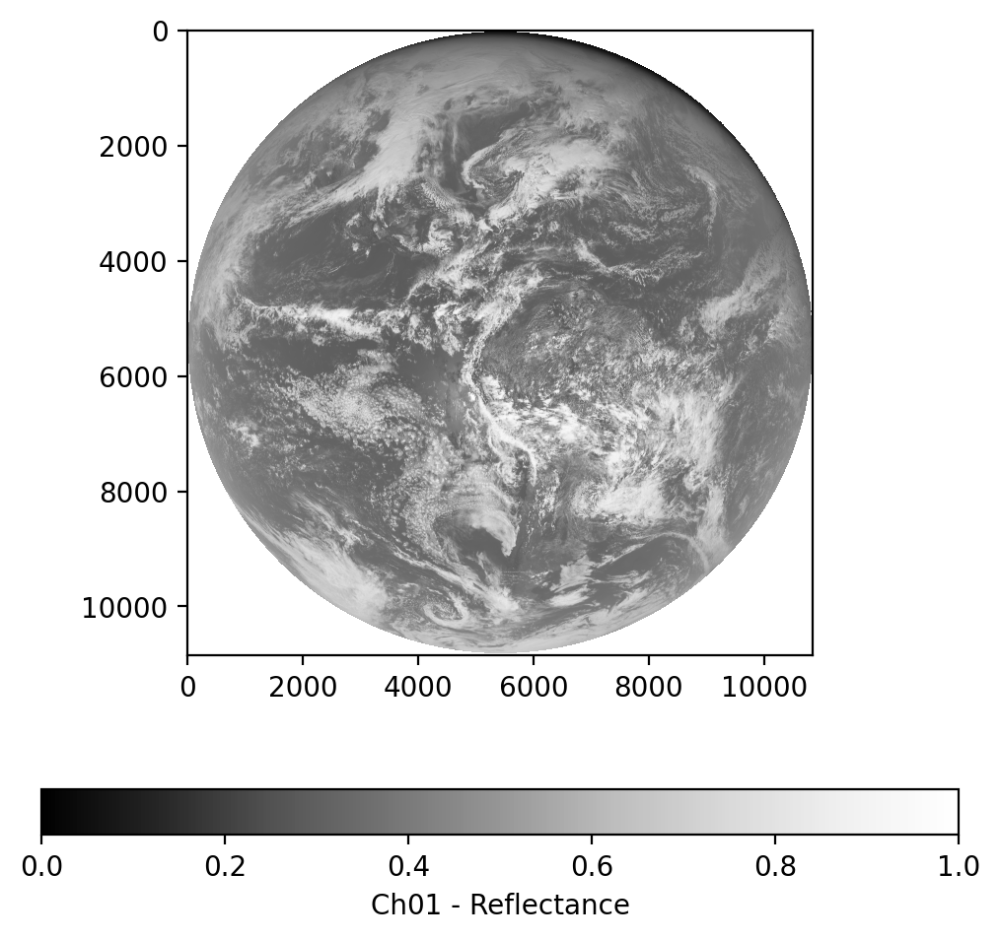

<ipython-input-23-a5aabae5e356>:98: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  radiance_3 = g16nc.variables['Rad'][:]
<ipython-input-23-a5aabae5e356>:98: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  radiance_3 = g16nc.variables['Rad'][:]
radiance_3 : [-4.122480392456055 -3.368655204772949 -2.9917430877685547 ...
 372.7900390625 373.1669921875 --]
ref_3 : [-0.008792988955974579 -0.0071851275861263275 -0.0063811978325247765 ...
 0.7951374650001526 0.7959414720535278 --]


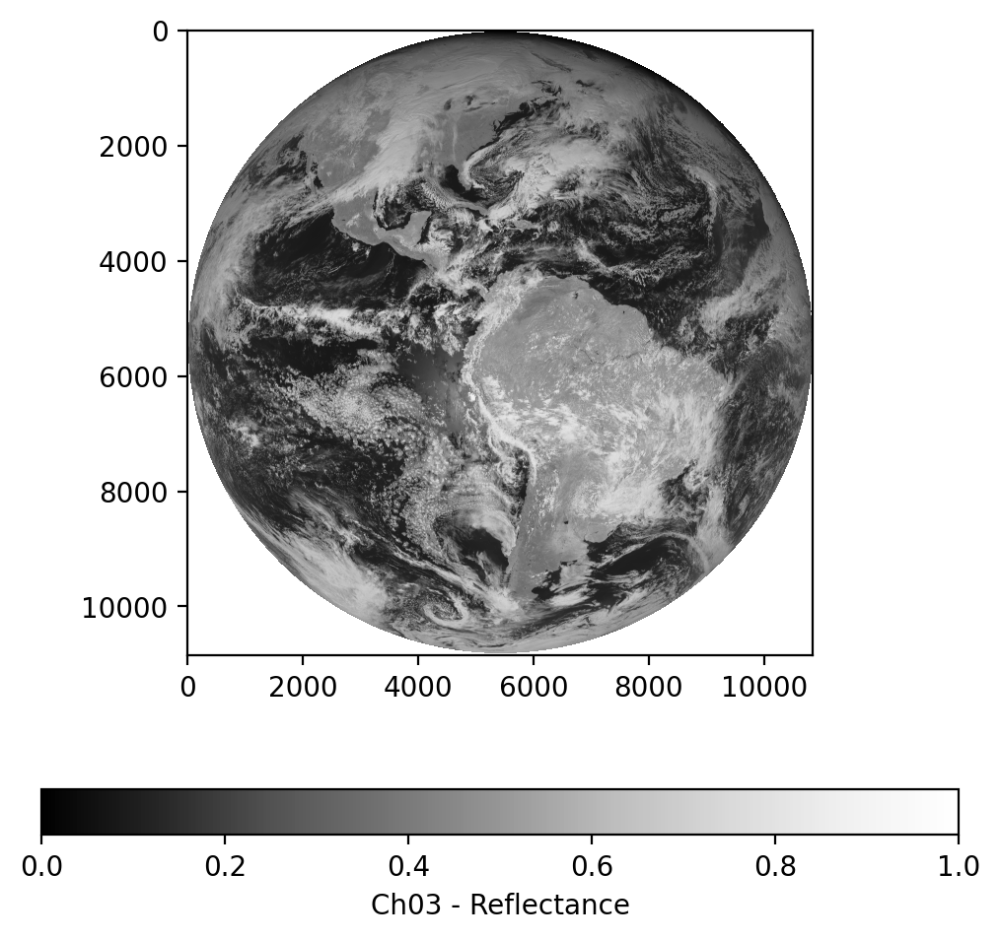

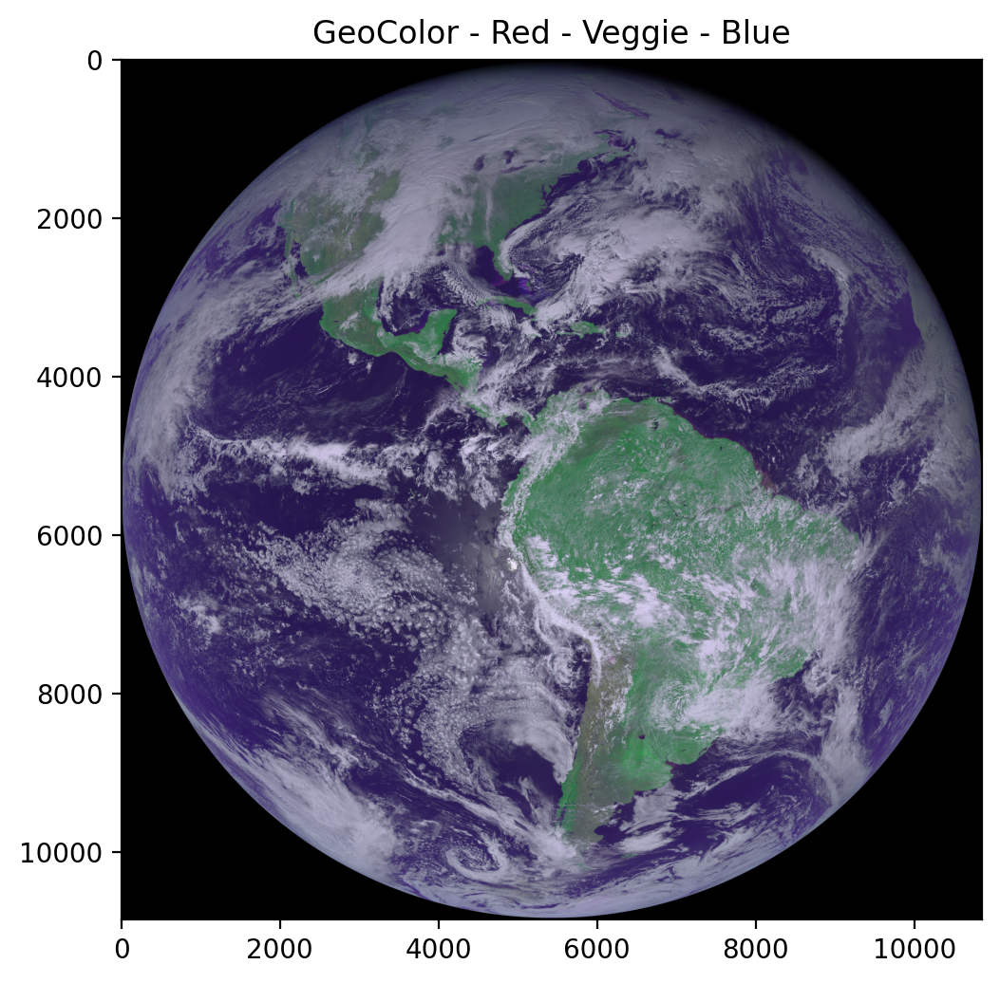

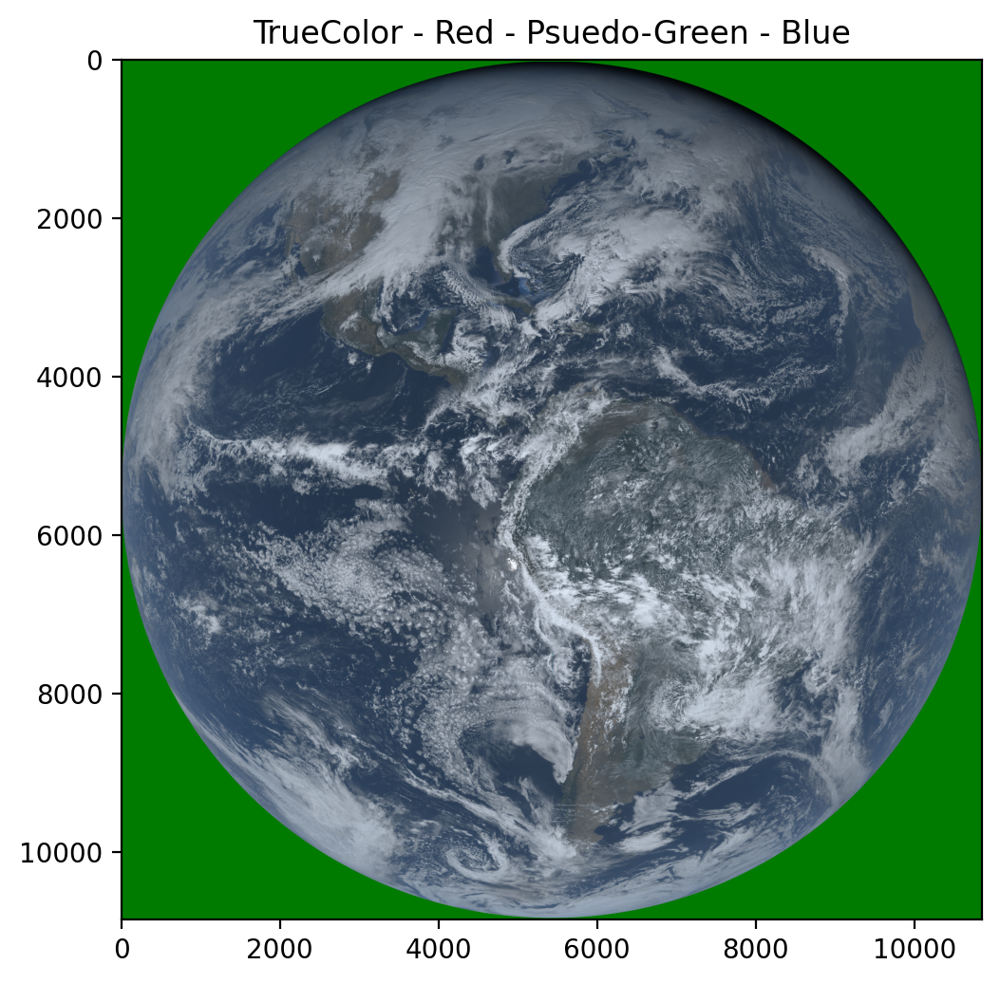

In [26]:
truecolor_planet = transform(file_channel1, file_channel2, file_channel3)

In [30]:
ds = nc.Dataset(file_channel2)
print(ds)

<class 'netCDF4._netCDF4.Dataset'>
root group (NETCDF4 data model, file format HDF5):
    naming_authority: gov.nesdis.noaa
    Conventions: CF-1.7
    standard_name_vocabulary: CF Standard Name Table (v35, 20 July 2016)
    institution: DOC/NOAA/NESDIS > U.S. Department of Commerce, National Oceanic and Atmospheric Administration, National Environmental Satellite, Data, and Information Services
    project: GOES
    production_site: WCDAS
    production_environment: OE
    spatial_resolution: 0.5km at nadir
    Metadata_Conventions: Unidata Dataset Discovery v1.0
    orbital_slot: GOES-East
    platform_ID: G16
    instrument_type: GOES R Series Advanced Baseline Imager
    scene_id: Full Disk
    instrument_ID: FM1
    title: ABI L1b Radiances
    summary: Single reflective band ABI L1b Radiance Products are digital maps of outgoing radiance values at the top of the atmosphere for visible and near-IR bands.
    keywords: SPECTRAL/ENGINEERING > VISIBLE WAVELENGTHS > VISIBLE RADIANCE
 

In [31]:
ds = nc.Dataset(to_open)
print(ds)

<class 'netCDF4._netCDF4.Dataset'>
root group (NETCDF4 data model, file format HDF5):
    HDF_LIB_VERSION: unknown
    MACHINE: solar3.ssec.wisc.edu
    PROGLANG: F90
    date_created: 2020-01-22T17:50:35+00:00
    product_version: v05r04
    summary:  To add
    cdr_variable:  To add
    institution:  NOAA/NESDIS and the University of Wisconsin-Madison / CIMSS
    cdr_program:  NOAA Climate Data Record Program for satellites
    title:  PATMOS-x
    calibration_version: mc5y2011
    keywords:  To add
    keywords_vocabulary:  To add
    time_coverage_resolution:   To add
    metadata_link:  To add
    spatial_resolution:  To add
    Conventions: CF-1.6
    Metadata_Conventions: CF-1.6, Unidata Dataset Discovery v1.0
    standard_name_vocabulary: CF Standard Name Table (v25, 05 July 2013)
    naming_authority: gov.noaa.ncdc
    license: No constraints on data access or use.
    sensor: GOES-RU-IMAGER
    platform: GOES-16
    FILENAME: clavrx_OR_ABI-L1b-RadF-M6C01_G16_s20200221740165_B

In [5]:
import satpy
BASE_DIR = '..\\NC\\aws\\'
scene = satpy.Scene(reader="abi_l1b", filenames=[file_channel1, file_channel2, file_channel3])
scene.load(["true_color"])

# it is necessary to "resample" here because the different channels are at
# different spatial resolution. By not passing in an "area" the highest
# resolution possible will be used
new_scn = scene.resample(resampler="native")

# get out a dask-backed DataArray for the composite
da_truecolor = new_scn["true_color"]

if "crs" in da_truecolor:
    da_truecolor = da_truecolor.drop("crs")

# to be able to crop the DataArray to the bounding box we need to set the
# projection attribute
da_truecolor.attrs["crs"] = scene.max_area().to_cartopy_crs()



C:\Users\Ray\anaconda3\lib\site-packages\pyproj\crs\crs.py:543: UserWarning: You will likely lose important projection information when converting to a PROJ string from another format. See: https://proj.org/faq.html#what-is-the-best-format-for-describing-coordinate-reference-systems
  proj_string = self.to_proj4()
The following datasets were not created and may require resampling to be generated: DataID(name='true_color')
C:\Users\Ray\anaconda3\lib\site-packages\pyproj\crs\crs.py:543: UserWarning: You will likely lose important projection information when converting to a PROJ string from another format. See: https://proj.org/faq.html#what-is-the-best-format-for-describing-coordinate-reference-systems
  proj_string = self.to_proj4()
C:\Users\Ray\anaconda3\lib\site-packages\pyproj\crs\crs.py:543: UserWarning: You will likely lose important projection information when converting to a PROJ string from another format. See: https://proj.org/faq.html#what-is-the-best-format-for-describing-coo

TypeError: Invalid shape (3, 21696, 21696) for image data

In [7]:
da_truecolor = da_truecolor.sortby("y", ascending=False)
img = satpy.writers.get_enhanced_image(da__truecolor)
plt.imshow(img)
plt.show()

NameError: name 'da_' is not defined

<ipython-input-8-0d3af53b370c>:4: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  radiance = g16nc.variables['Rad'][:]
<ipython-input-8-0d3af53b370c>:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  radiance = g16nc.variables['Rad'][:]


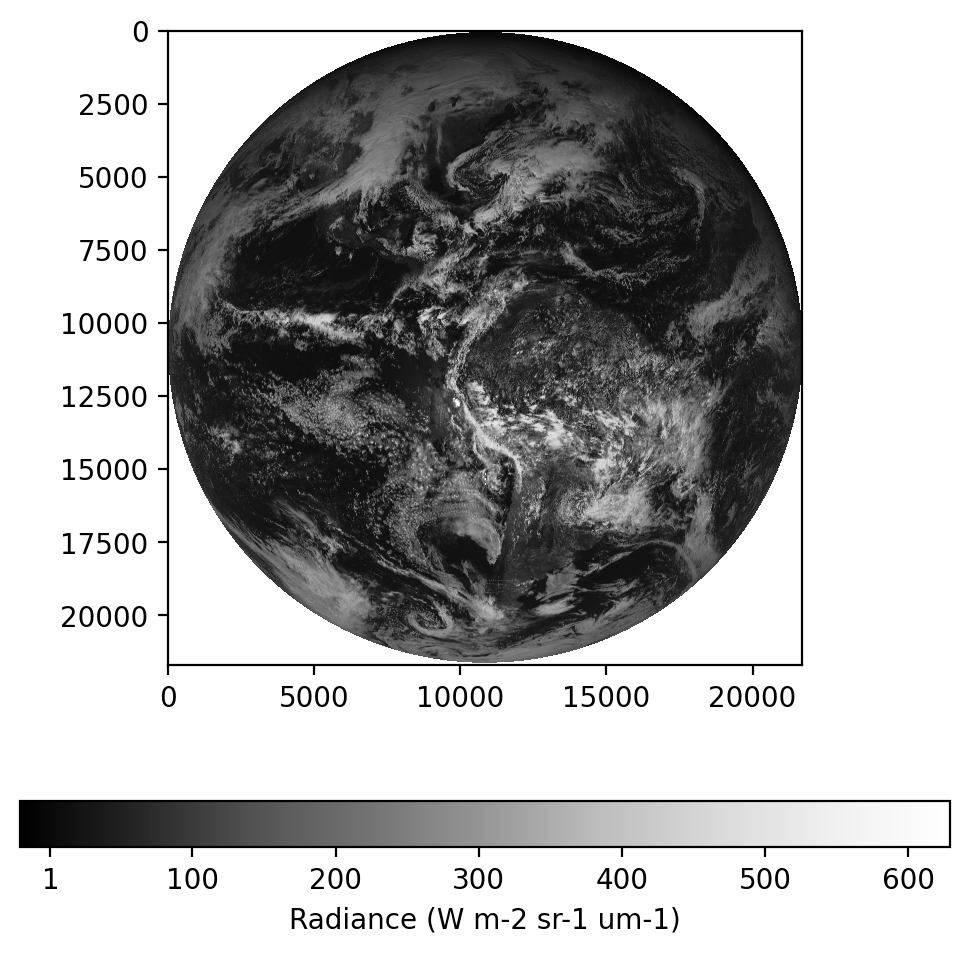




{'HDF_LIB_VERSION': 'unknown', 'MACHINE': 'solar3.ssec.wisc.edu', 'PROGLANG': 'F90', 'date_created': '2020-01-22T17:50:35+00:00', 'product_version': 'v05r04', 'summary': ' To add', 'cdr_variable': ' To add', 'institution': ' NOAA/NESDIS and the University of Wisconsin-Madison / CIMSS', 'cdr_program': ' NOAA Climate Data Record Program for satellites', 'title': ' PATMOS-x', 'calibration_version': 'mc5y2011', 'keywords': ' To add', 'keywords_vocabulary': ' To add', 'time_coverage_resolution': '  To add', 'metadata_link': ' To add', 'spatial_resolution': ' To add', 'Conventions': 'CF-1.6', 'Metadata_Conventions': 'CF-1.6, Unidata Dataset Discovery v1.0', 'standard_name_vocabulary': 'CF Standard Name Table (v25, 05 July 2013)', 'naming_authority': 'gov.noaa.ncdc', 'license': 'No constraints on data access or use.', 'sensor': 'GOES-RU-IMAGER', 'platform': 'GOES-16', 'FILENAME': 'clavrx_OR_ABI-L1b-RadF-M6C01_G16_s20200221740165_BARBADOS-2KM-FD.level2.nc', 'L1B': 'clavrx_OR_ABI-L1b-RadF-M6

In [8]:
to_open = "..\\NC\\aws\\OR_ABI-L1b-RadF-M6C02_G16_s20200221740165_e20200221749473_c20200221749525.nc"
g16nc = nc.Dataset(to_open, 'r')
#radiance = g16nc.variables['Rad'][:]
radiance = g16nc.variables['Rad'][:]
g16nc.close()
#print(g16nc.__dict__)
fig = plt.figure(figsize=(6,6),dpi=200)
im = plt.imshow(radiance, cmap='Greys_r')
cb = fig.colorbar(im, orientation='horizontal')
cb.set_ticks([1, 100, 200, 300, 400, 500, 600])
cb.set_label('Radiance (W m-2 sr-1 um-1)')
plt.show()
g16nc = None

print("\n\n")
to_open = "..\\NC\\2km_10min\\2020\\2020_01_22\\clavrx_OR_ABI-L1b-RadF-M6C01_G16_s20200221740165_BARBADOS-2KM-FD.level2.nc"
g16nc = nc.Dataset(to_open, 'r')
#radiance = g16nc.variables['Rad'][:]
print(g16nc.__dict__)
g16nc = None